## Notebook to assess potential machine learning applications to GTD 18 dataset

In [1]:
import pandas as pd
import numpy as np
from pandas_profiling import ProfileReport

#### Import local GTD data

In [2]:
gtd_path = 'GTD_13_18.csv'

gtd_df = pd.read_csv(gtd_path)

c:\users\richard.boulet\documents\python_all\python_projects\gtd\gtd_env\lib\site-packages\IPython\core\interactiveshell.py:3145: DtypeWarning: Columns (39,41,77,78) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [3]:
# check dataframe

# Dont limit dataframe size
pd.set_option("display.max_rows", 1_000)
pd.set_option("display.max_columns", 99)

gtd_df.columns

Index(['NAME', 'CONTINENT', 'eventid', 'iyear', 'imonth', 'iday', 'region_txt',
       'provstate', 'city', 'latitude', 'longitude', 'summary',
       'alternative_txt', 'multiple', 'success', 'suicide', 'attacktype1',
       'attacktype1_txt', 'attacktype2', 'attacktype2_txt', 'attacktype3',
       'attacktype3_txt', 'targtype1', 'targtype1_txt', 'targsubtype1',
       'targsubtype1_txt', 'corp1', 'target1', 'natlty1', 'natlty1_txt',
       'targtype2', 'targtype2_txt', 'targsubtype2', 'targsubtype2_txt',
       'corp2', 'target2', 'natlty2', 'natlty2_txt', 'gname', 'gsubname',
       'gname2', 'gsubname2', 'motive', 'guncertain1', 'guncertain2',
       'guncertain3', 'individual', 'nperps', 'nperpcap', 'claimed',
       'claimmode', 'claimmode_txt', 'compclaim', 'weaptype1', 'weaptype1_txt',
       'weapsubtype1', 'weapsubtype1_txt', 'weaptype2', 'weaptype2_txt',
       'weapsubtype2', 'weapsubtype2_txt', 'nkill', 'nkillus', 'nkillter',
       'nwound', 'nwoundus', 'nwoundte', 'prope

In [4]:
print(gtd_df.isna().sum())

NAME                       0
CONTINENT                  0
eventid                    0
iyear                      0
imonth                     0
iday                       0
region_txt                 0
provstate                  2
city                       0
latitude                   0
longitude                  0
summary                    0
alternative_txt        91757
multiple                   1
success                    0
suicide                    0
attacktype1                0
attacktype1_txt            0
attacktype2           107575
attacktype2_txt       107575
attacktype3           112431
attacktype3_txt       112431
targtype1                  0
targtype1_txt              0
targsubtype1            8022
targsubtype1_txt        8022
corp1                      0
target1                    0
natlty1                 1415
natlty1_txt             1415
targtype2             103071
targtype2_txt         103071
targsubtype2          103105
targsubtype2_txt      103105
corp2         

### Clean up data that have +100K nulls 

In [5]:
# loop and add columns that have more than 100K nulls, add to list, and will then drop 

columns_to_drop = []

for col in gtd_df.columns:
    
    if gtd_df[col].isna().sum() > 100_000:
        
        columns_to_drop.append(col)

        
columns_to_drop

['attacktype2',
 'attacktype2_txt',
 'attacktype3',
 'attacktype3_txt',
 'targtype2',
 'targtype2_txt',
 'targsubtype2',
 'targsubtype2_txt',
 'corp2',
 'target2',
 'natlty2',
 'natlty2_txt',
 'gsubname',
 'gname2',
 'gsubname2',
 'guncertain2',
 'guncertain3',
 'compclaim',
 'weaptype2',
 'weaptype2_txt',
 'weapsubtype2',
 'weapsubtype2_txt',
 'nhostkid',
 'nhostkidus',
 'nhours',
 'ndays',
 'divert',
 'kidhijcountry',
 'ransom',
 'hostkidoutcome',
 'hostkidoutcome_txt',
 'nreleased']

In [6]:
gtd_df.drop(columns_to_drop, 1, inplace = True)

In [7]:
gtd_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112822 entries, 0 to 112821
Data columns (total 59 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   NAME              112822 non-null  object 
 1   CONTINENT         112822 non-null  object 
 2   eventid           112822 non-null  int64  
 3   iyear             112822 non-null  int64  
 4   imonth            112822 non-null  int64  
 5   iday              112822 non-null  int64  
 6   region_txt        112822 non-null  object 
 7   provstate         112820 non-null  object 
 8   city              112822 non-null  object 
 9   latitude          112822 non-null  float64
 10  longitude         112822 non-null  float64
 11  summary           112822 non-null  object 
 12  alternative_txt   21065 non-null   object 
 13  multiple          112821 non-null  float64
 14  success           112822 non-null  int64  
 15  suicide           112822 non-null  int64  
 16  attacktype1       11

In [8]:
import folium
import config 

world_map = folium.Map(location=[44.66,10.66], 
                       zoom_start = 3, 
                       tiles = config.keys,
                       attr = 'Navigation'
                       )

# for label, lat, lng in zip(gtd_countries_transport['Name'], gtd_countries_transport['lat'], gtd_countries_transport['lon']):
#     folium.Marker(
#         [lat, lng],
#         radius=5,
#         color='red',
#         icon=folium.Icon(color='green'),
#         popup=label,
#         fill = True,
#         fill_color='red',
#         fill_opacity=0.6
#     ).add_to(world_map)


In [9]:
gtd_df.head(2)


,NAME,CONTINENT,eventid,iyear,imonth,iday,region_txt,provstate,city,latitude,longitude,summary,alternative_txt,multiple,success,suicide,attacktype1,attacktype1_txt,targtype1,targtype1_txt,targsubtype1,targsubtype1_txt,corp1,target1,natlty1,natlty1_txt,gname,motive,guncertain1,individual,nperps,nperpcap,claimed,claimmode,claimmode_txt,weaptype1,weaptype1_txt,weapsubtype1,weapsubtype1_txt,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,propextent,propextent_txt,propvalue,propcomment,ishostkid,addnotes,scite1,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,Belize,North America,201301150025,2013,1,15,Central America & Caribbean,Belize,Belize City,17.497717,-88.186833,01/15/2013: Gunmen fired into the house of for...,NaN,0.0,1,0,7,Facility/Infrastructure Attack,2,Government (General),17.0,Head of State,Government of Belize,Former Prime Minister: Said Musa,22.0,Belize,Unknown,NaN,0,0,-99,0,0,NaN,NaN,5,Firearms,5.0,Unknown Gun Type,0.0,0.0,0.0,0.0,0.0,0.0,1,3.0,Minor (likely < $1 million),-99.0,The front door of a civilian home and a vehicl...,0,NaN,"""BELIZE-POLITICS-Police protection for former ...",START Primary Collection,-9,-9,0,-9,NaN
1,Guatemala,North America,201301150024,2013,1,14,Central America & Caribbean,Jutiapa,Jutiapa,14.284180,-89.892811,01/14/2013: Assailants opened fire on Carlos E...,NaN,0.0,1,0,1,Assassination,2,Government (General),15.0,Politician or Political Party Movement/Meeting...,Government of Jutiapa,Mayor: Carlos Enrique Castillo Medrano,83.0,Guatemala,Unknown,NaN,0,0,2,0,0,NaN,NaN,5,Firearms,5.0,Unknown Gun Type,1.0,0.0,0.0,0.0,0.0,0.0,0,NaN,NaN,NaN,NaN,0,NaN,"""Guatemalan politician shot dead,"" BBC, Januar...",START Primary Collection,-9,-9,0,-9,NaN


### Count of events by country for top 5 countries

In [10]:
country_counts = gtd_df.NAME.value_counts().head(50)

country_counts

Iraq                        25293
Afghanistan                 13506
Pakistan                    11408
India                        7186
Philippines                  5230
Somalia                      4679
Nigeria                      4582
Yemen                        4440
Libya                        3813
Ukraine                      3230
Egypt                        3190
Syria                        3109
Thailand                     2698
Turkey                       2310
Bangladesh                   1547
Colombia                     1173
Palestinian Territory        1125
Sudan                        1124
Congo DRC                     997
Israel                        919
United Kingdom                902
Mali                          748
Lebanon                       722
Kenya                         672
Nepal                         537
Saudi Arabia                  526
Cameroon                      495
Russian Federation            432
Burundi                       398
Central Africa

### Select certain countries to analyze 

In [11]:
countries = ['Iraq']

gtd_countries = gtd_df[gtd_df['NAME'].isin(countries)]

In [12]:
gtd_countries.head(2)

,NAME,CONTINENT,eventid,iyear,imonth,iday,region_txt,provstate,city,latitude,longitude,summary,alternative_txt,multiple,success,suicide,attacktype1,attacktype1_txt,targtype1,targtype1_txt,targsubtype1,targsubtype1_txt,corp1,target1,natlty1,natlty1_txt,gname,motive,guncertain1,individual,nperps,nperpcap,claimed,claimmode,claimmode_txt,weaptype1,weaptype1_txt,weapsubtype1,weapsubtype1_txt,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,propextent,propextent_txt,propvalue,propcomment,ishostkid,addnotes,scite1,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
30126,Iraq,Asia,201301010002,2013,1,1,Middle East & North Africa,Saladin,Tuz Khormato,34.886283,44.629025,01/01/2013: An explosives-laden vehicle detona...,NaN,1.0,1,0,3,Bombing/Explosion,14,Private Citizens & Property,75.0,Village/City/Town/Suburb,Not Applicable,Civilians,95.0,Iraq,Unknown,NaN,0,0,-99,0,0,NaN,NaN,6,Explosives/Bombs/Dynamite,15.0,Vehicle,1.0,0.0,0.0,5.0,0.0,0.0,1,3.0,Minor (likely < $1 million),-99.0,Nearby homes and a fuel station were damaged i...,0,Casualty numbers for this incident represent a...,"""Deadly bombing leaves destruction in Kirkuk,""...",START Primary Collection,-9,-9,0,-9,"201301010002, 201301010003"
30127,Iraq,Asia,201301010003,2013,1,1,Middle East & North Africa,Saladin,Tuz Khormato,34.886283,44.629025,01/01/2013: At least two explosives detonated ...,NaN,1.0,1,0,3,Bombing/Explosion,3,Police,25.0,Police Security Forces/Officers,Iraqi Police Service (IPS),Police First Responders,95.0,Iraq,Unknown,NaN,0,0,-99,0,0,NaN,NaN,6,Explosives/Bombs/Dynamite,16.0,Unknown Explosive Type,0.0,0.0,0.0,5.0,0.0,0.0,1,3.0,Minor (likely < $1 million),-99.0,Nearby homes and a fuel station were damaged i...,0,Casualty numbers for this incident represent a...,"""Deadly bombing leaves destruction in Kirkuk,""...",START Primary Collection,-9,-9,0,-9,"201301010003, 201301010002"


### Now that the countries we are interseted in have been sliced out, we will dive deeper into individual rows of data and clean or remove rows as appropriate

In [13]:
# Profile the dataset

# profile = gtd_countries.profile_report(title='Pandas Profiling Report')
# profile.to_file(output_file="gtd_pandas_profiling.html")

In [14]:
gtd_countries.targtype1_txt.unique()

array(['Private Citizens & Property', 'Police', 'Government (General)',
       'Unknown', 'Terrorists/Non-State Militia', 'Military',
       'Religious Figures/Institutions', 'Business',
       'Educational Institution', 'Violent Political Party', 'Utilities',
       'Transportation', 'Other', 'Government (Diplomatic)',
       'Journalists & Media', 'Airports & Aircraft', 'Maritime',
       'Tourists', 'Food or Water Supply', 'Telecommunication', 'NGO'],
      dtype=object)

## Explore only rows that have transportation as an attack target

In [15]:
gtd_countries_transport = gtd_countries[gtd_countries.targtype1_txt == 'Transportation']

gtd_countries_transport.head(2)

,NAME,CONTINENT,eventid,iyear,imonth,iday,region_txt,provstate,city,latitude,longitude,summary,alternative_txt,multiple,success,suicide,attacktype1,attacktype1_txt,targtype1,targtype1_txt,targsubtype1,targsubtype1_txt,corp1,target1,natlty1,natlty1_txt,gname,motive,guncertain1,individual,nperps,nperpcap,claimed,claimmode,claimmode_txt,weaptype1,weaptype1_txt,weapsubtype1,weapsubtype1_txt,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,propextent,propextent_txt,propvalue,propcomment,ishostkid,addnotes,scite1,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
30258,Iraq,Asia,201302080013,2013,2,8,Middle East & North Africa,Karbala,Karbala,32.614300,44.02483,02/08/2013: An explosives-laden vehicle explod...,NaN,0.0,1,0,3,Bombing/Explosion,19,Transportation,105.0,Taxi/Rickshaw,Unknown,Taxi Stand,95.0,Iraq,Unknown,"The specific motive is unknown; however, sourc...",0,0,-99,0,0,NaN,NaN,6,Explosives/Bombs/Dynamite,15.0,Vehicle,5.0,0.0,0.0,16.0,0.0,0.0,-9,NaN,NaN,NaN,It is unknown if a taxi stand was damaged in t...,0,Casualty numbers for this attack conflict acro...,"""Car bombs kill 36 in Iraq's bloodiest day sin...",START Primary Collection,-9,-9,0,-9,NaN
30289,Iraq,Asia,201302170006,2013,2,17,Middle East & North Africa,Baghdad,Baghdad,33.374692,44.44754,02/17/2013: A car bomb detonated at a bus stat...,NaN,1.0,1,0,3,Bombing/Explosion,19,Transportation,101.0,Bus Station/Stop,Unknown,Bus Station,95.0,Iraq,Al-Qaida in Iraq,Al-Qa ida in Iraq stated that this string of a...,0,0,-99,0,1,7.0,"Posted to website, blog, etc.",6,Explosives/Bombs/Dynamite,15.0,Vehicle,4.0,0.0,0.0,10.0,0.0,0.0,1,3.0,Minor (likely < $1 million),-99.0,A bus station was damaged in this attack,0,Casualty numbers for this attack represent an ...,"""Blasts in Baghdad's Shiite Neighborhoods Kill...",START Primary Collection,0,0,0,0,"201302170006, 201302170005, 201302170007, 2013..."


## Map with certain country events shown

In [16]:
for attack, target, desc, lat, lng in zip(gtd_countries_transport['attacktype1_txt'], gtd_countries_transport['targsubtype1_txt'], gtd_countries_transport['summary'], gtd_countries_transport['latitude'], gtd_countries_transport['longitude']):
    folium.Marker(
        [lat, lng],
        radius=5,
        color='red',
        icon=folium.Icon(color='blue'),
        popup= (attack, target),
        fill = True,
        fill_color='red',
        fill_opacity=0.6
    ).add_to(world_map)
    
world_map

## Graphs to explore data

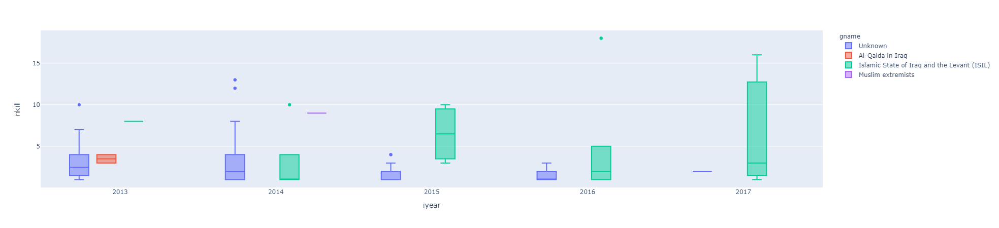

In [17]:
import plotly.express as px

gtd_countries_deaths = gtd_countries_transport[gtd_countries_transport.nkill > 0]

fig = px.box(gtd_countries_deaths, x = 'iyear', y = 'nkill', color = 'gname')
fig.show()

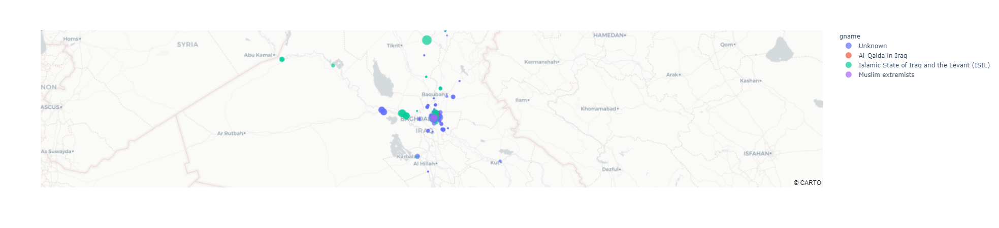

In [18]:
fig = px.scatter_mapbox(gtd_countries_deaths, lat="latitude", lon="longitude", color="gname", size="nkill",
                  color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=6,
                  mapbox_style="carto-positron")
fig.show()

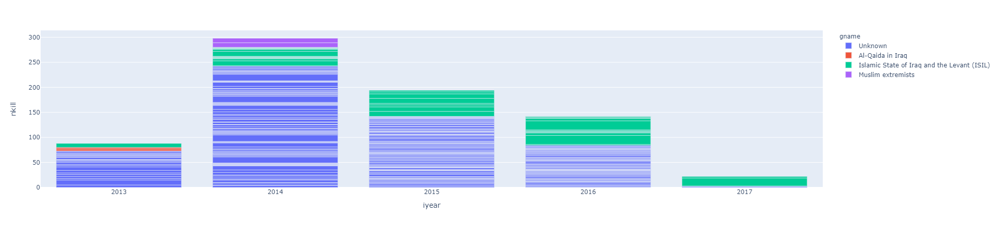

In [19]:
fig = px.bar(gtd_countries_deaths, x = 'iyear', y = 'nkill', color = 'gname')
fig.show()

## From the above two charts we can see that attacks against transportation in general that resulted in deaths seem to be centered in the Baghdad area over the years 2013 - 2018. Additionally, ISIL is the group (other than unidentified assailants) that has conducted the highest number of attacks against transportation that resulted in deaths, with their largest transportation attack resulting in 18 deaths. ISIL's most active year of attacks against transportation that resulted in deaths was roughly 55 persons in 2016. 

# Advanced Use Cases - Cleaning Data 

## The examples below show more advanced abilities of various packages to:

### - ID missing data points
### - Cleaning missing data
### - ID correlations between features in data

## These packages are intended to speed up and increase usability of data versus programming/ slicing/ manually cleaning data as I did above. THESE ARE BRUTE FORCE METHODS AND SHOULD BE USED SPARINGLY FOR FINAL FEATURE CREATION WHEN CLEANING DATA. 

## Identify Missing Values across a dataset

In [20]:
# Reload data from initial csv file again to show ease of cleaning with various package

gtd_path = 'GTD_13_18.csv'

gtd_df = pd.read_csv(gtd_path)

c:\users\richard.boulet\documents\python_all\python_projects\gtd\gtd_env\lib\site-packages\IPython\core\interactiveshell.py:3145: DtypeWarning:

Columns (39,41,77,78) have mixed types.Specify dtype option on import or set low_memory=False.



## The next step looks at brute force cleaning data. The following is done to the dataset to clean it:

### - Converts column names to underscores_lowercase_all
### - Drops empty or nearly (90%) empty columns of data
### - Removes single value columns
### - Drops duplicate rows
### - Optimizes datatypes (if it can be stored as integer versus a float it may attempt that, or if an int64 bit data type can be converted to a smaller int32 bit data type it will)

GridSpec(6, 6)

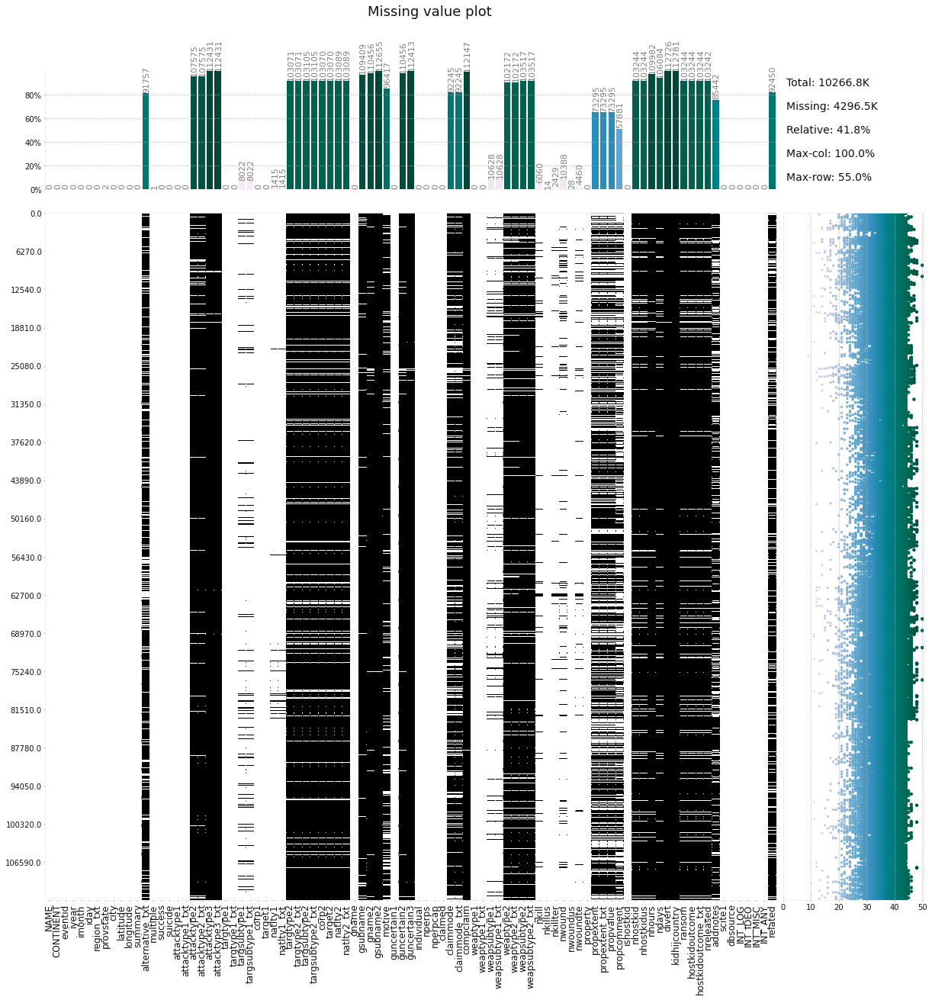

In [21]:
import klib


klib.missingval_plot(gtd_df) 

In [22]:
gtd_cleaned = klib.data_cleaning(gtd_df)

Shape of cleaned data: (103401, 58) - Remaining NAs: 812395

Changes:
Dropped rows: 9421
     of which 9421 duplicates. (Rows: [45, 47, 48, 49, 50, 51, 53, 54, 56, 66, 67, 68, 69, 70, 71, 232, 233, 238, 244, 245, 251, 253, 259, 262, 263, 264, 265, 266, 267, 269, 270, 271, 272, 273, 277, 278, 279, 283, 284, 285, 288, 289, 291, 296, 297, 298, 302, 304, 305, 307, 309, 310, 316, 317, 321, 324, 325, 328, 329, 330, 331, 332, 333, 340, 341, 346, 349, 350, 352, 355, 358, 361, 362, 439, 441, 442, 444, 445, 448, 464, 476, 514, 515, 528, 535, 536, 537, 538, 539, 540, 541, 542, 543, 545, 564, 608, 611, 612, 614, 615, 616, 617, 618, 620, 621, 622, 627, 690, 691, 692, 693, 694, 695, 696, 697, 698, 699, 700, 701, 702, 703, 705, 706, 708, 709, 710, 712, 714, 715, 716, 718, 719, 720, 721, 722, 723, 724, 725, 727, 728, 730, 731, 732, 733, 745, 758, 759, 760, 761, 764, 766, 774, 780, 781, 1359, 1360, 1362, 1367, 1368, 1370, 1372, 1376, 1379, 1380, 1381, 1385, 1393, 1399, 1400, 1401, 1402, 1403, 1406, 142

## Identify correlations between data points

<AxesSubplot:title={'center':'Feature-correlation (pearson)'}>

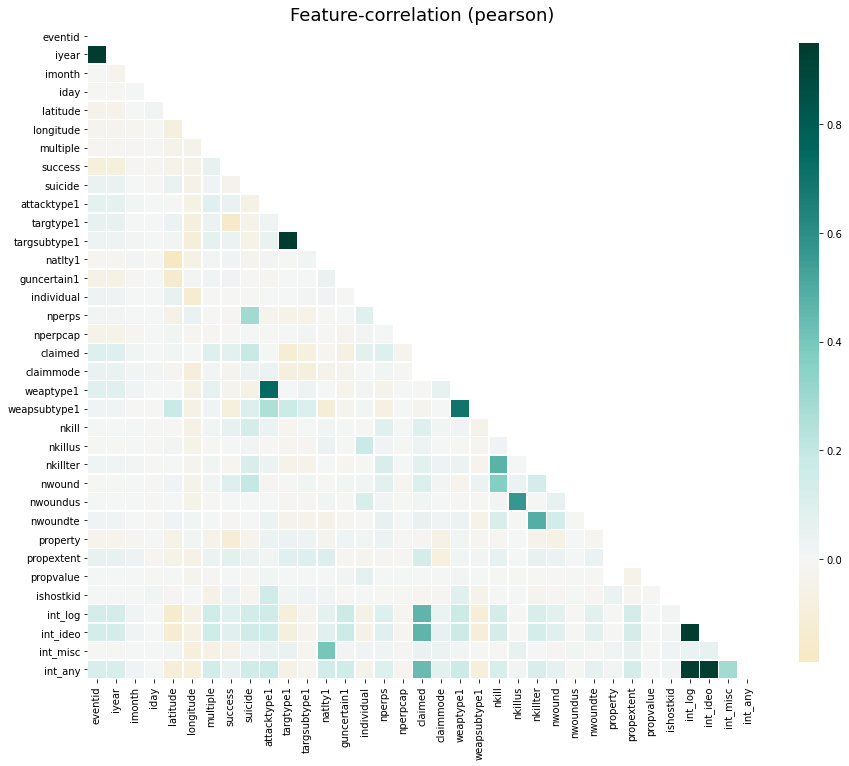

In [23]:
klib.corr_plot(gtd_cleaned, annot=False, figsize=(15,12))


Displaying positive correlations. Specify a positive "threshold" to further limit the results.


<AxesSubplot:title={'center':'Feature-correlation (pearson)'}>

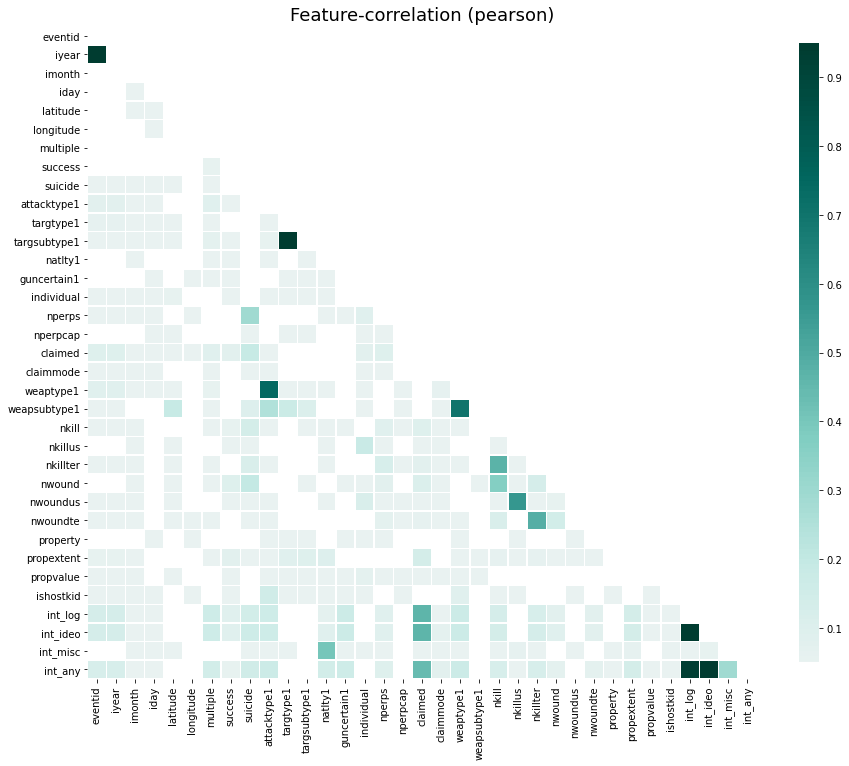

In [24]:
klib.corr_plot(gtd_cleaned, split='pos', annot=False, figsize=(15,12))


Displaying negative correlations. Specify a negative "threshold" to further limit the results.


<AxesSubplot:title={'center':'Feature-correlation (pearson)'}>

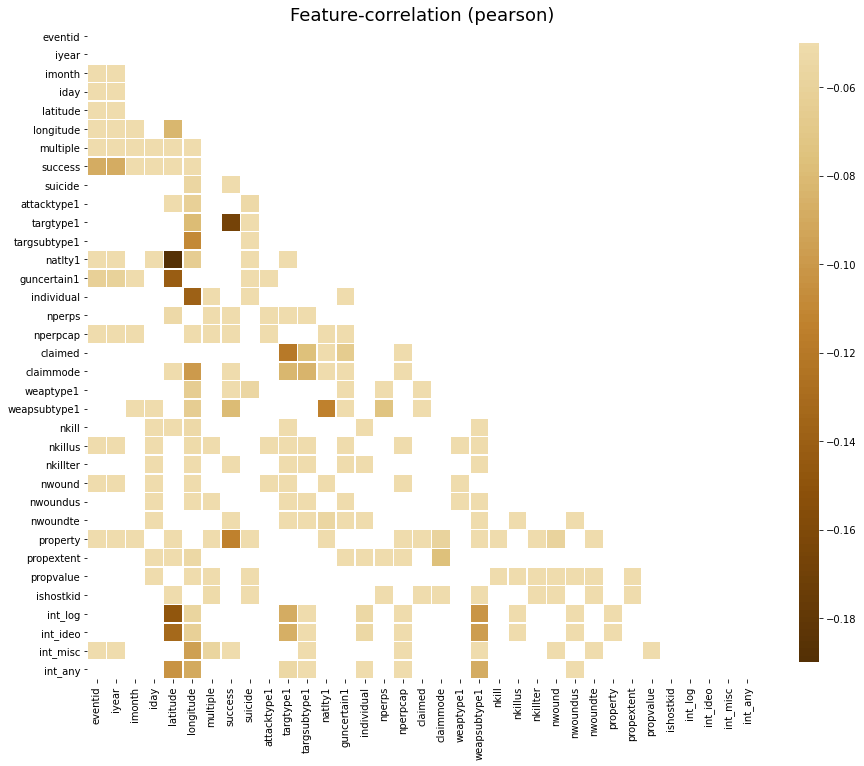

In [25]:
klib.corr_plot(gtd_cleaned, split='neg', annot=False, figsize=(15,12))

### Not surprisingly there are strong postiive correlations in events between deaths and injuries. It is hard to find any clear unknown correlations. In this case we could attempt to feed this data to somehting like a Random Forest model to try and derive meaning from things that we are unable to identify with simple correlations.

## Looking at target varible correlations within the data ( we will attempt to identify what correlations might exist related to attack methods)

<AxesSubplot:title={'center':'Feature-correlation (pearson)'}>

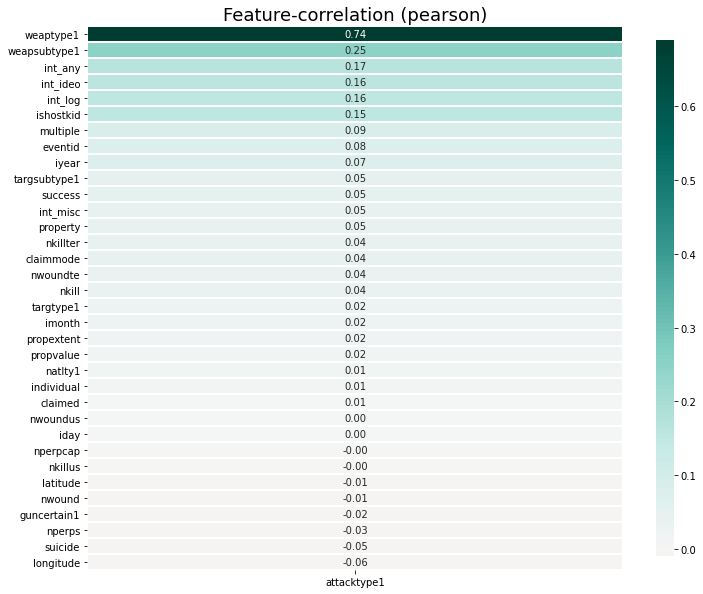

In [26]:
klib.corr_plot(gtd_cleaned, target = 'attacktype1')

<AxesSubplot:title={'center':'Feature-correlation (spearman)'}>

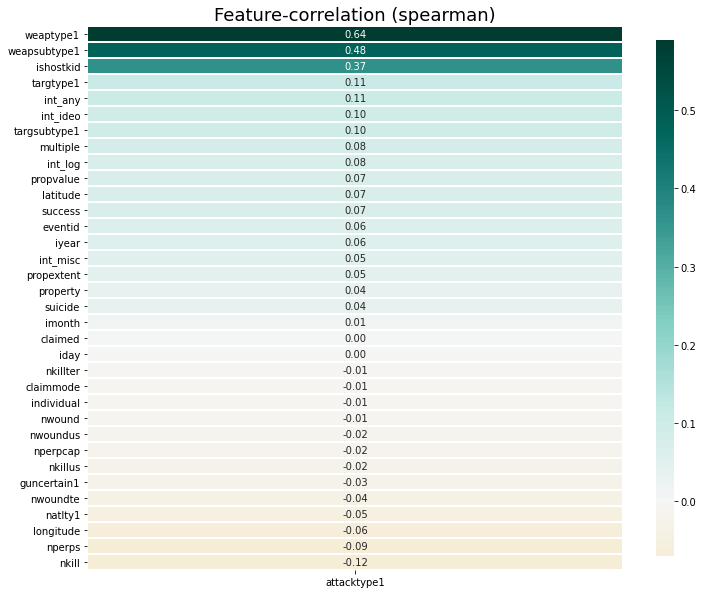

In [27]:
klib.corr_plot(gtd_cleaned, target = 'attacktype1', method = 'spearman')

<AxesSubplot:title={'center':'Feature-correlation (kendall)'}>

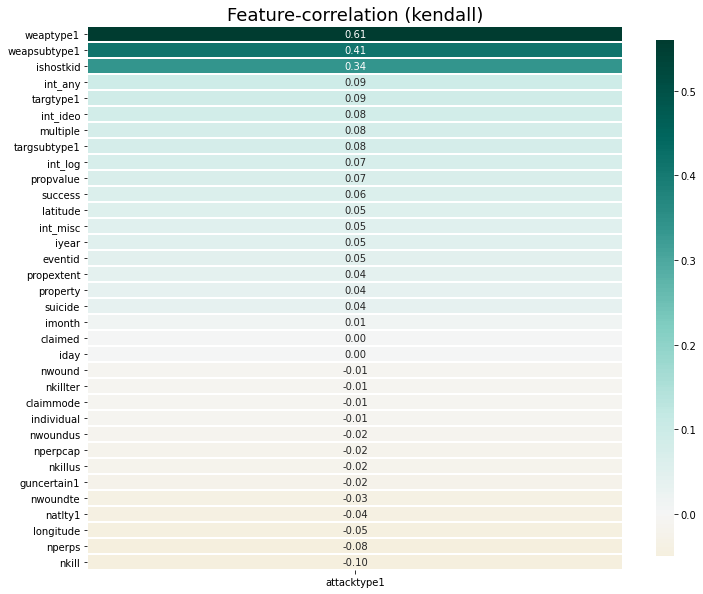

In [28]:
klib.corr_plot(gtd_cleaned, target = 'attacktype1', method = 'kendall')

## A really nice feature of klib package is categorical column vizualization, something that is obviously not the case when computing correlations. This helps identify how and to what extent to apply categorical encoding to categories when training models that require purely numeric inputs.

## Now that our data was cleaned (the rushed way) we can look at applying the data to various models. Throwing the kitchensink at the data is the wrong approach, but we will demonstrate the capabilities of easily fitting numerous types of models to the data using Pycaret.

GridSpec(6, 6)

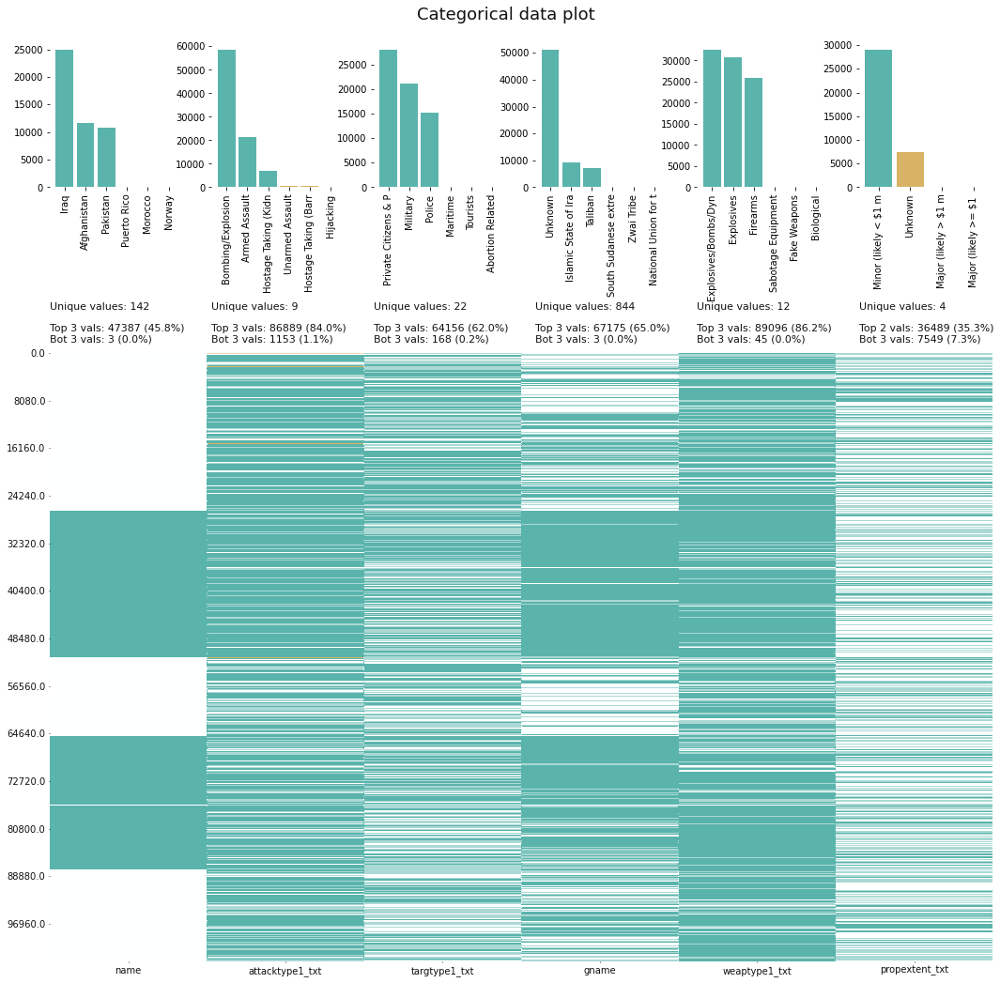

In [29]:
gtd_clean_text = gtd_cleaned[['name', 'attacktype1_txt', 'targtype1_txt', 'gname', 'weaptype1_txt', 'propextent_txt']]

klib.cat_plot(gtd_clean_text)

## From the methods above, in a real world situation of modeling, domain expertise would be critical to identify the causalities, and if they are being accounted for appropriately, with the correlations we found, and did not find, above. 

# Modeling

### Now that our data was cleaned (the rushed way) we can look at applying the data to various models. We will also look at "throwing the kitchensink" at the data (using a package called pycaret) which is the wrong approach, but we will demonstrate the capabilities of easily fitting numerous types of models to the data.

## Model 1. Exploring Unsupervised Clustering with K-Means

### A simple and easy way to tell if underlying patterns and clusters exist in the data is to do an unsupervised  clustering to see if the model can differentiate between data points on it's own, without providing labeled data points to make assumptions on, which we will do later on. 

In [30]:
# library modules for k-means

import matplotlib.pyplot as plt
from kneed import KneeLocator
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler

### Before we can use k-means to find clusters, the numeric data must be put on the same scale, and any categorical data taken out. We will also add a new categorical encoding for each categorical data we want to include prior to dropping categorical columns.

In [31]:
# Drop rows where group name is unknown

gtd_cleaned_unknown = gtd_cleaned[gtd_cleaned.gname != 'Unknown']  # We end up with 52K rows of data after dropping unknowns, still plenty of data for modelling purposes


# Identify columns we want to keep and encode

columns_to_encode = ['name', 'city', 'gname']


# Encode colummns identified, and add them to our dataset

for column in columns_to_encode:
    
    gtd_cleaned_unknown[column] = gtd_cleaned_unknown[column].astype('category')
    
    gtd_cleaned_unknown[f'{column}_category'] = gtd_cleaned_unknown[column].cat.codes


<ipython-input-31-6de026fbde72>:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-31-6de026fbde72>:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [32]:
# Setting new dataset to only include numeric data, taking out categorical data

numeric_gtd_cleaned = gtd_cleaned_unknown.select_dtypes(['number'])


# Dropping columns that I will not include in analyses

drop_columns = ['multiple', 'success', 'nperpcap', 'claimed', 'int_log', 'int_ideo', 'int_misc', 'int_any']

(
    numeric_gtd_cleaned.drop(drop_columns, inplace = True, axis = 1)
                       .reset_index(drop = True, inplace=True)
)


c:\users\richard.boulet\documents\python_all\python_projects\gtd\gtd_env\lib\site-packages\pandas\core\frame.py:4162: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



### Final k-means feature dataset so we can reuse the clean numeric gtd dataset later on in other models, before any information like eventid and lat long get removed (and also Nans). Also avoids scaling the data for models where it isnt necessary, like Random Forest

In [33]:
# Dropping things that dont have influence on kmeans like eventid, lat, long, etc

drop_columns = ['eventid', 'latitude', 'longitude']

kmeans_features = numeric_gtd_cleaned.drop(drop_columns, axis = 1)

In [52]:
kmeans_features.isna().sum()

iyear                 0
imonth                0
iday                  0
suicide               0
attacktype1           0
targtype1             0
targsubtype1       2297
natlty1             501
guncertain1           0
individual            0
nperps                0
claimmode         33587
weaptype1             0
weapsubtype1       6863
nkill              3926
nkillus              10
nkillter           1941
nwound             7088
nwoundus             25
nwoundte           3543
property              0
propextent        32854
propvalue         32854
ishostkid             0
name_category         0
city_category         0
gname_category        0
dtype: int64

### Getting rid of NaNs in the data, since kmeans cannot operate over missing values in algorithm. Using a simple mean to fill the data for the sake of quick and dirty example, but far more care would need to be taken in this case when the data is really being ingested in model in which results are informing decisions. There are methods to impute values via MICE, drop certain rows, etc that can be used versus a simple mean imputation.


In [53]:
# Using fillna function in pandas to replace column Nans

kmeans_features.fillna(kmeans_features.mean(), inplace = True)

iyear             0
imonth            0
iday              0
suicide           0
attacktype1       0
targtype1         0
targsubtype1      0
natlty1           0
guncertain1       0
individual        0
nperps            0
claimmode         0
weaptype1         0
weapsubtype1      0
nkill             0
nkillus           0
nkillter          0
nwound            0
nwoundus          0
nwoundte          0
property          0
propextent        0
propvalue         0
ishostkid         0
name_category     0
city_category     0
gname_category    0
dtype: int64

### Now that we have our final features for our kmeans analysis we will rescale the dataset, since kemans determines the centroid of various data points, and to find the correct distance between points they need to all be on the same scale.

In [54]:
# Set the scaler we want to use, we will be using standard transformation (mean of 0, stdev of 1 for all data)

scaler = StandardScaler()

scaled_features = scaler.fit_transform(kmeans_features)

### Next we will set the model parameters we want with kmeans. Then we will look at optimizing the kmeans parameters to get the best fit for the number of clusters we will display.

In [58]:
# Initial kmeans model

# Setting parameters for kmeans algorithm
kmeans = KMeans( 
    init = 'random',
    n_clusters = 10,
    n_init = 10, 
    max_iter = 300,
    random_state = 42
)

# Fit scaled features to kmeans algo

kmeans.fit(scaled_features)

KMeans(init='random', n_clusters=10, random_state=42)

### Now that our scaled data was fit to the algorithm, we can check the predicted labels for the clusters

In [66]:
# Check the first 50 labels that the model found

kmeans.labels_[:50]

array([0, 4, 7, 7, 7, 7, 7, 7, 7, 7, 7, 4, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7,
       7, 2, 1, 2, 2, 2, 2, 2, 2, 2, 7, 6, 7, 2, 2, 2, 2, 2, 2, 2, 2, 1,
       2, 2, 0, 2, 2, 2])

### Since we initally just selected a number of clusters we want to "bin" the data to, we will now tune the parameters of the kmeans model to find the number of clusters that provide the most meaningful differentiation.

In [77]:
# Set our keyword arguments
# kmeans_kwargs = {
#     'init': 'random',
#     'n_init': 20,
#     'max_iter': 300,
#     'random_state': 42
# }

# # Get list of sum square error (SSE) to assess distance between a point and its centroid (we want to reduce this so things are clustered nicely).
# # We will loop through various n_cluster values to try and identify the point in which meaningful differentiation ceases.

# sse_list = []

# for k in range(1, 30):
    
#     kmeans = KMeans(n_clusters = k, **kmeans_kwargs)
    
#     kmeans.fit(scaled_features)
    
#     sse_list.append(kmeans.inertia_)
    


### Get a list of the sum sqaured errors to plot

In [78]:
# sse_list

[1413303.375,
 1322675.875,
 1253942.25,
 1209833.875,
 1156879.25,
 1102459.0,
 1083581.75,
 1035798.4375,
 1002408.5,
 976361.6875,
 966739.5625,
 948184.9375,
 928184.0625,
 924086.4375,
 886572.9375,
 876090.6875,
 849711.0,
 841415.6875,
 833771.375,
 821889.5,
 810898.3125,
 800199.1875,
 769818.6875,
 757660.875,
 735107.0,
 732485.9375,
 718231.8125,
 714874.0,
 712549.25]

### Graph the SSE values from our list to try and identify an elbow point, or optimal number of clusters, on our own.

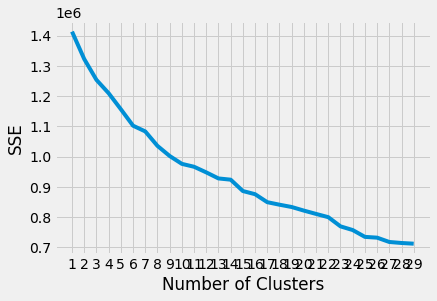

In [80]:
# Plotting results of SSE list in order to see the 'elbow', or ideal stopping point, for the number of clusters used in our kmeans algorithm. We will use the matplotlib module to plot here.

# plt.style.use('fivethirtyeight')
# plt.plot(range(1, 30), sse_list)
# plt.xticks(range(1, 30))
# plt.xlabel('Number of Clusters')
# plt.ylabel('SSE')
# plt.show()

### Use a module to detect the oelbow, or optimal number of clusters, for our dataset.

In [81]:
# # It is hard to distinguish an elbow, or optimal cluster point from the graph above, and will look at a package called kneed to see if it can detect it for us.

# kl = KneeLocator( range(1,30), sse_list, curve = 'convex', direction = 'decreasing')

# kl.elbow

10

### While I am not sure this dataset is great for performing simple kmeans clustering on given in part to the large amount of locations and group combinations, we could look at other clustering algorithms adn take the time to analyze the data to find if the data truly should be clustered, and which method may fit the data best. However in this quick example, the kneelocator function identified 10 as the elbow point for use later on.

### We will also look at finding the silhouette coefficient, which will show how well values will fit into their clusters, by finding how close the data point is to other data points in the same cluster group, and also how far a point is from other points in the same cluster group.

In [82]:
# # List of silhouette coefficients

# silh_coefficients = []

# for k in range(2, 30):
    
#     kmeans = KMeans(n_clusters = k, **kmeans_kwargs)
    
#     kmeans.fit(scaled_features)
    
#     score = silhouette_score(scaled_features, kmeans.labels_)
    
#     silh_coefficients.append(score)
    

### Plot the silhouette scores

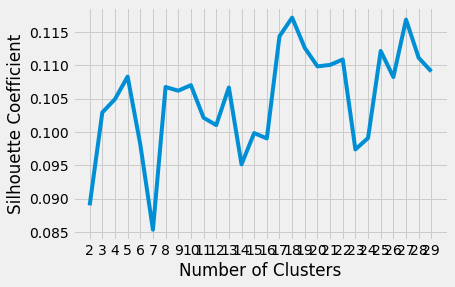

In [83]:
# plt.style.use('fivethirtyeight')
# plt.plot(range(2, 30), silh_coefficients)
# plt.xticks(range(2, 30))
# plt.xlabel('Number of Clusters')
# plt.ylabel('Silhouette Coefficient')
# plt.show()

### Based on the chart above, we want to select the number of clusters value that returns the highest silhouette cofficients. But, we also need to take into account the elbow value, as well as domain expertise in order to ensure that the correct number of clusters is selected. Based on these we could look at setting the number of clusters to 10, since the silhouette coeffiecient is slightly higher than others here, or test to see the results from setting the cluster to 17 or 27, which have the highest sihouette coefficients. HOwever, our coefficients appear fairly low, which may show us that we may not have great clustering results in the end. 

### Now we will set the kmeans algorithm to our desired parameters and append them to the original dataset to see how they plot.

In [85]:
# Set parameters for kmeans

kmeans = KMeans( 
    init = 'random',
    n_clusters = 10,
    n_init = 20, 
    max_iter = 300,
    random_state = 42
)


# Fit scaled features to kmeans algo

kmeans.fit(scaled_features)

KMeans(init='random', n_clusters=10, n_init=20, random_state=42)

In [86]:
# Joining parameters to original dataset

gtd_cleaned_unknown['cluster_group'] = kmeans.labels_

<ipython-input-86-9eefebe5a58c>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



### Plotting the cluster results geographically by cluster group

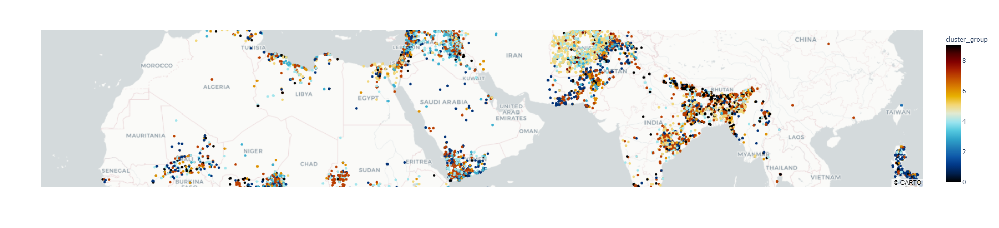

In [92]:
fig = px.scatter_mapbox(gtd_cleaned_unknown, 
                        lat="latitude", 
                        lon="longitude", 
                        color="cluster_group",
                        color_continuous_scale=px.colors.cyclical.IceFire, 
                        size_max=15, 
                        zoom=3,
                        mapbox_style="carto-positron",
                        hover_data = ['gname', 'nkill', 'attacktype1_txt'])
fig.show()

### From the map above it is hard to see much distinction geographically, but can look at the data based on cluster group to see if we can find some rhyme and reason behind the cluster groups. We may also find our clustering methodology overall was not performed as well as it could have been :)

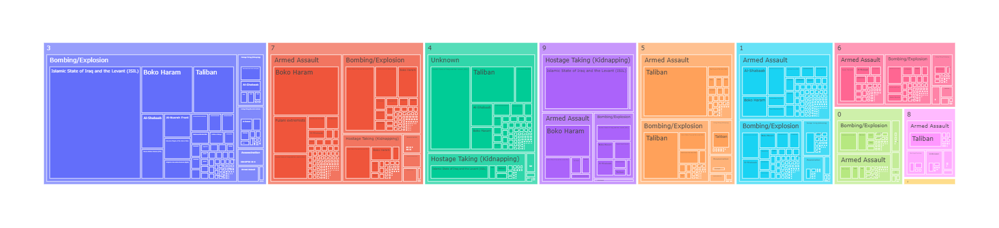

In [132]:
fig = px.treemap(gtd_cleaned_unknown, path = ['cluster_group', 'attacktype1_txt', 'gname'], values = 'nkill', hover_data = ['gname'])

fig.show()

### From the treemap above, we can drill into the specific groups to see what type of attack was used, and try to get some understanding of the cluster they were assigned. We can make some estimates that cluster group 3 consists of a lot of bombing and explosion attacks, and that the number of persons killed was high. Additionally, we can see cluster 7 that there is an equal mix of armed assualts and bombing explsions, that also resulted in higher number of casualties. In cluster 9, we can see hostage taking as the predominant attack type, with ISIS peforming a majority of hostage taking, and also resulted in high deaths. In cluster 7 we can see a high amount of deaths from armed assaults carried out by Boko Haram.